In [2]:
import multiprocessing

cores = multiprocessing.cpu_count() # Count the number of cores in a computer
cores

2

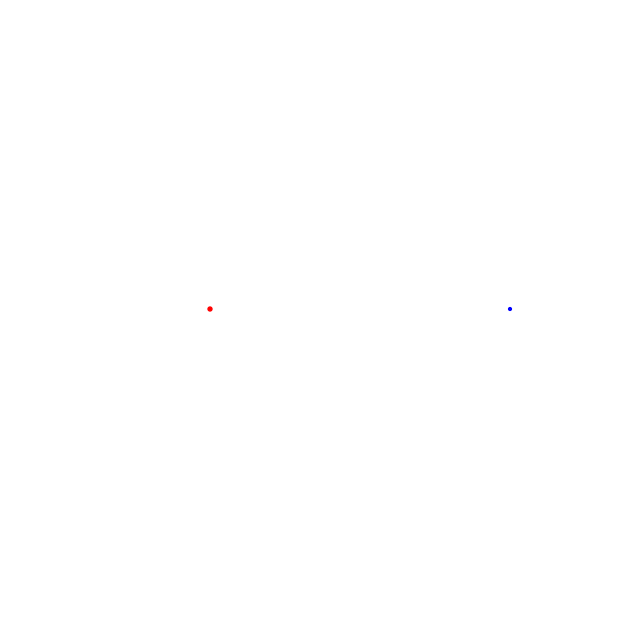

In [32]:
import matplotlib.pyplot as plt
import matplotlib.animation
import numpy as np

import scipy.integrate

m1 = 1
(x1, y1) = (1.0, 0.0)
(vx1, vy1) = (0, 0.0)

m2 = 2
(x2, y2) = (-0.5, 0.0)
(vx2, vy2) = (0, -0.1)

def grav(x1, y1, x2, y2):   
    # inverse square law between two particles mass m1, m2
    dx = x2 - x1
    dy = y2 - y1
    r2 = dx * dx + dy * dy
    r3 = r2 ** 1.5
    fx = dx / r3
    fy = dy / r3
    return (fx/m1, fy/m1, -fx/m2, -fy/m2)

rs = [x1, y1, x2, y2]
vs = [vx1, vy1, vx2, vy2]
y = rs + vs

def fun(t, y):
    (x1, y1, x2, y2, vx1, vy1, vx2, vy2) = tuple(y)
    (ax1, ay1, ax2, ay2) = grav(x1, y1, x2, y2)
    return [vx1, vy1, vx2, vy2, ax1, ay1, ax2, ay2]

res = scipy.integrate.solve_ivp(fun, (0, 50), y)
ts = res.t
ys = res.y

fig = plt.figure(figsize=[6,6])
ax = plt.axes([0., 0., 1., 1.], xlim=(-1.5,1.5), ylim=(-1.5,1.5))
ax.set_aspect('equal')
ax.axis('off')
l = ax.scatter([x1, x2], [y1, y2], c=['blue', 'red'], s=[4, 8])

def animate(i):
    l.set_offsets(np.reshape(ys [0:4, i], (2,2)))

ani = matplotlib.animation.FuncAnimation(fig, animate, frames=len(ts))

from IPython.display import HTML
HTML(ani.to_jshtml())


In [4]:
ts.shape

(306,)

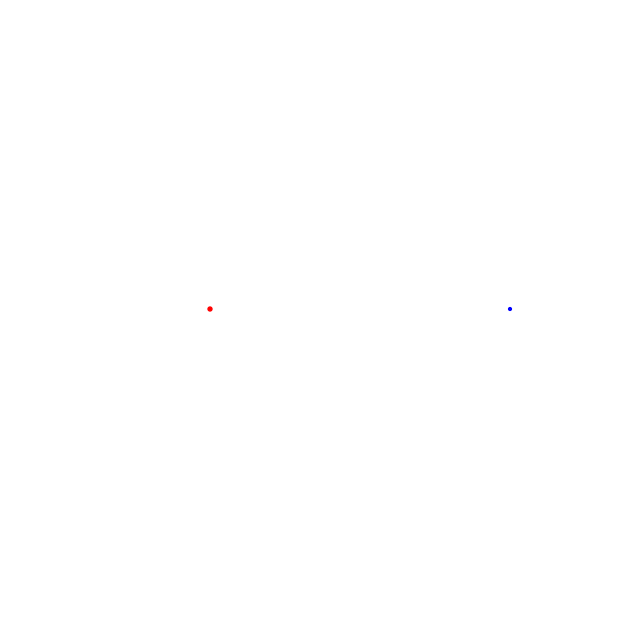

In [9]:
import matplotlib.pyplot as plt
import matplotlib.animation
import numpy as np

m1 = 1
(x1, y1) = (1.0, 0.0)
(vx1, vy1) = (0, 0.2)

m2 = 2
(x2, y2) = (-0.5, 0.0)
(vx2, vy2) = (0, -0.1)

def grav(x1, y1, x2, y2):   
    # inverse square law between two particles mass m1, m2
    dx = x2 - x1
    dy = y2 - y1
    r2 = dx * dx + dy * dy
    r3 = r2 ** 1.5
    fx = dx / r3
    fy = dy / r3
    return (fx/m1, fy/m1, -fx/m2, -fy/m2)

t=0
tend=50
dt = 0.01
NITER = int((tend - t)/dt + 0.5)

ys = np.zeros((4, NITER + 1))
ys [:, 0] = [x1, y1, x2, y2]

(ax1, ay1, ax2, ay2) = grav(x1, y1, x2, y2)
for i in range(NITER):
    vx1 += 0.5 * dt * ax1
    vy1 += 0.5 * dt * ay1
    vx2 += 0.5 * dt * ax2
    vy2 += 0.5 * dt * ay2
    x1 += dt * vx1
    y1 += dt * vy1
    x2 += dt * vx2
    y2 += dt * vy2
    (ax1, ay1, ax2, ay2) = grav(x1, y1, x2, y2)
    vx1 += 0.5 * dt * ax1
    vy1 += 0.5 * dt * ay1
    vx2 += 0.5 * dt * ax2
    vy2 += 0.5 * dt * ay2
    ys [:, i+1] = [x1, y1, x2, y2]

fig = plt.figure(figsize=[6,6])
ax = plt.axes([0., 0., 1., 1.], xlim=(-1.5,1.5), ylim=(-1.5,1.5))
ax.set_aspect('equal')
ax.axis('off')
l = ax.scatter([x1, x2], [y1, y2], c=['blue', 'red'], s=[4, 8])

OUTPUT_FREQ=10 # display every 10 steps only

def animate(i):
    l.set_offsets(np.reshape(ys [0:4, OUTPUT_FREQ * i], (2,2)))

ani = matplotlib.animation.FuncAnimation(fig, animate, frames=int(NITER/OUTPUT_FREQ))

from IPython.display import HTML
HTML(ani.to_jshtml())

In [10]:
ys.shape

(4, 5001)

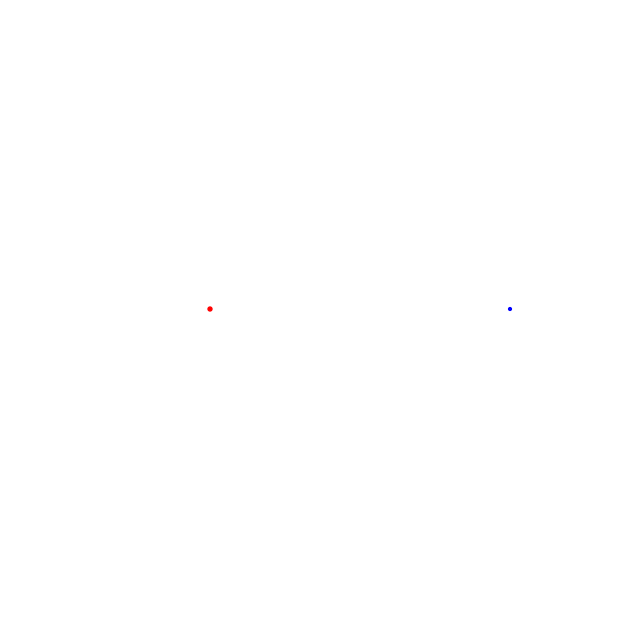

In [31]:
import matplotlib.pyplot as plt
import matplotlib.animation
import numpy as np

m1 = 1
(x1, y1) = (1.0, 0.0)
(vx1, vy1) = (0, 0.0)

m2 = 2
(x2, y2) = (-0.5, 0.0)
(vx2, vy2) = (0, -0.1)

def grav(x1, y1, x2, y2): 
  # inverse square law between two particles mass m1, m2
  dx = x2 - x1
  dy = y2 - y1
  r2 = dx * dx + dy * dy
  r3 = r2 ** 1.5
  fx = dx / r3
  fy = dy / r3
  return (fx/m1, fy/m1, -fx/m2, -fy/m2)

t=0
tend=50
dt = 0.01
NITER = int((tend - t)/dt + 0.5)

ys = np.zeros((4, NITER + 1))
ys [:, 0] = [x1, y1, x2, y2]

(ax1, ay1, ax2, ay2) = grav(x1, y1, x2, y2)
for i in range(NITER):
  # update positions using velocity Verlet formula
  x1 += dt * vx1 + 0.5 * dt * dt * ax1
  y1 += dt * vy1 + 0.5 * dt * dt * ay1
  x2 += dt * vx2 + 0.5 * dt * dt * ax2
  y2 += dt * vy2 + 0.5 * dt * dt * ay2

  # calculate new forces at new positions
  (ax1_new, ay1_new, ax2_new, ay2_new) = grav(x1, y1, x2, y2)

  # update velocities using velocity Verlet formula
  vx1 += 0.5 * dt * (ax1 + ax1_new)
  vy1 += 0.5 * dt * (ay1 + ay1_new)
  vx2 += 0.5 * dt * (ax2 + ax2_new)
  vy2 += 0.5 * dt * (ay2 + ay2_new)

  # store the new positions in the array
  ys [:, i+1] = [x1, y1, x2, y2]

  # update the old forces with the new ones
  ax1 = ax1_new
  ay1 = ay1_new
  ax2 = ax2_new
  ay2 = ay2_new

fig = plt.figure(figsize=[6,6])
ax = plt.axes([0., 0., 1., 1.], xlim=(-1.5,1.5), ylim=(-1.5,1.5))
ax.set_aspect('equal')
ax.axis('off')
l = ax.scatter([x1, x2], [y1, y2], c=['blue', 'red'], s=[4, 8])

OUTPUT_FREQ=10 # display every 10 steps only

def animate(i):
    l.set_offsets(np.reshape(ys [0:4, OUTPUT_FREQ * i], (2,2)))

ani = matplotlib.animation.FuncAnimation(fig, animate, frames=int(NITER/OUTPUT_FREQ))

from IPython.display import HTML
HTML(ani.to_jshtml())

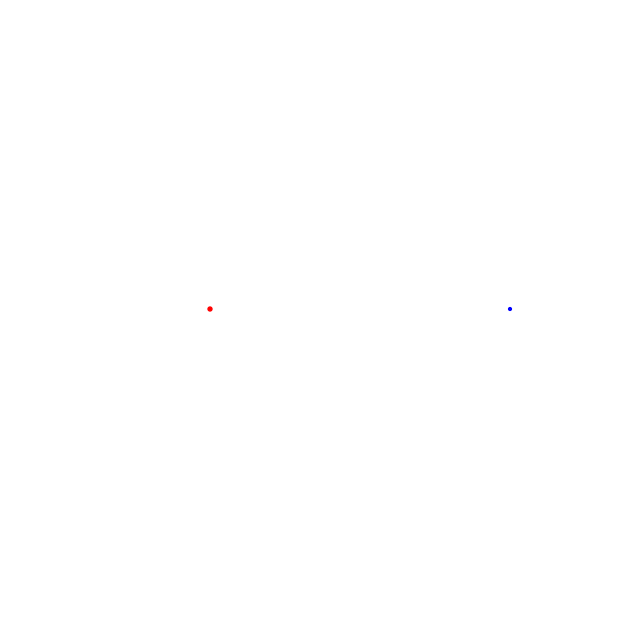

In [24]:
import matplotlib.pyplot as plt
import matplotlib.animation
import numpy as np

import scipy.integrate

m1 = 1
(x1, y1) = (1.0, 0.0)
(vx1, vy1) = (0, 0.2)

m2 = 2
(x2, y2) = (-0.5, 0.0)
(vx2, vy2) = (0, -0.1)

def grav(x1, y1, x2, y2):   
    # inverse square law between two particles mass m1, m2
    dx = x2 - x1
    dy = y2 - y1
    r2 = dx * dx + dy * dy
    r3 = r2 ** 1.5
    fx = dx / r3
    fy = dy / r3
    return (fx/m1, fy/m1, -fx/m2, -fy/m2)

rs = [x1, y1, x2, y2]
vs = [vx1, vy1, vx2, vy2]
y = rs + vs

def fun(t, y):
    (x1, y1, x2, y2, vx1, vy1, vx2, vy2) = tuple(y)
    (ax1, ay1, ax2, ay2) = grav(x1, y1, x2, y2)
    return [vx1, vy1, vx2, vy2, ax1, ay1, ax2, ay2]

res = scipy.integrate.solve_ivp(fun, (0, 50), y, method="Radau")
ts = res.t
ys = res.y

fig = plt.figure(figsize=[6,6])
ax = plt.axes([0., 0., 1., 1.], xlim=(-1.5,1.5), ylim=(-1.5,1.5))
ax.set_aspect('equal')
ax.axis('off')
l = ax.scatter([x1, x2], [y1, y2], c=['blue', 'red'], s=[4, 8])

def animate(i):
    l.set_offsets(np.reshape(ys [0:4, i], (2,2)))

ani = matplotlib.animation.FuncAnimation(fig, animate, frames=len(ts))

from IPython.display import HTML
HTML(ani.to_jshtml())
